<a href="https://colab.research.google.com/github/ktakanov/baseline/blob/master/MasterDegreeBaseline.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Loading drive

In [ ]:
import os
import sys
import numpy as np

In [ ]:
from google.colab import drive
# 4/vAFKK2XMqhFnE1xT-qBasfw57ybPZ0tPSdrKKA5CYUcvl9NlLtBXVoE
drive.mount('/content/gdrive', force_remount=True)

Mounted at /content/gdrive


In [ ]:
import os
os.chdir('/content/gdrive/My Drive/recsys/buyer_classification/baseline/')

In [ ]:
!wget http://s3-eu-west-1.amazonaws.com/yc-rdata/yoochoose-data.7z

--2020-09-05 19:41:08--  http://s3-eu-west-1.amazonaws.com/yc-rdata/yoochoose-data.7z
Resolving s3-eu-west-1.amazonaws.com (s3-eu-west-1.amazonaws.com)... 52.218.96.194
Connecting to s3-eu-west-1.amazonaws.com (s3-eu-west-1.amazonaws.com)|52.218.96.194|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 287211932 (274M) [application/octet-stream]
Saving to: ‘yoochoose-data.7z.4’

yoochoose-data.7z.4 100%[===================>] 273.91M  60.2MB/s    in 4.5s    

2020-09-05 19:41:13 (60.7 MB/s) - ‘yoochoose-data.7z.4’ saved [287211932/287211932]



In [ ]:
!7z x yoochoose-data.7z.1


7-Zip [64] 16.02 : Copyright (c) 1999-2016 Igor Pavlov : 2016-05-21
p7zip Version 16.02 (locale=en_US.UTF-8,Utf16=on,HugeFiles=on,64 bits,4 CPUs Intel(R) Xeon(R) CPU @ 2.00GHz (50653),ASM,AES-NI)

Scanning the drive for archives:
  0M Scan         1 file, 287211932 bytes (274 MiB)

Extracting archive: yoochoose-data.7z.1
--
Path = yoochoose-data.7z.1
Type = 7z
Physical Size = 287211932
Headers Size = 255
Method = LZMA:24
Solid = +
Blocks = 2

  0%    
Would you like to replace the existing file:
  Path:     ./yoochoose-buys.dat
  Size:     55583744 bytes (54 MiB)
  Modified: 2020-08-16 18:39:25
with the file from archive:
  Path:     yoochoose-buys.dat
  Size:     55583744 bytes (54 MiB)
  Modified: 2014-11-05 14:25:04
? (Y)es / (N)o / (A)lways / (S)kip all / A(u)to rename all / (Q)uit? A

  0% - yoochoose-buys.dat                           1% - yoochoose-buys.dat                      

In [ ]:
!head yoochoose-clicks.dat

1,2014-04-07T10:51:09.277Z,214536502,0
1,2014-04-07T10:54:09.868Z,214536500,0
1,2014-04-07T10:54:46.998Z,214536506,0
1,2014-04-07T10:57:00.306Z,214577561,0
2,2014-04-07T13:56:37.614Z,214662742,0
2,2014-04-07T13:57:19.373Z,214662742,0
2,2014-04-07T13:58:37.446Z,214825110,0
2,2014-04-07T13:59:50.710Z,214757390,0
2,2014-04-07T14:00:38.247Z,214757407,0
2,2014-04-07T14:02:36.889Z,214551617,0


In [ ]:
import pandas as pd
dc = pd.read_csv('../yoochoose-clicks.dat',sep=',',header=None)
dc

/usr/local/lib/python3.6/dist-packages/IPython/core/interactiveshell.py:2718: DtypeWarning: Columns (3) have mixed types.Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


,0,1,2,3
0,1,2014-04-07T10:51:09.277Z,214536502,0
1,1,2014-04-07T10:54:09.868Z,214536500,0
2,1,2014-04-07T10:54:46.998Z,214536506,0
3,1,2014-04-07T10:57:00.306Z,214577561,0
4,2,2014-04-07T13:56:37.614Z,214662742,0
...,...,...,...,...
33003939,11299809,2014-09-25T09:33:22.412Z,214819412,S
33003940,11299809,2014-09-25T09:43:52.821Z,214830939,S
33003941,11299811,2014-09-24T19:02:09.741Z,214854855,S
33003942,11299811,2014-09-24T19:02:11.894Z,214854838,S


In [ ]:
dc.columns = ['session_id','timestamp','item_id','category']
dc

,session_id,timestamp,item_id,category
0,1,2014-04-07T10:51:09.277Z,214536502,0
1,1,2014-04-07T10:54:09.868Z,214536500,0
2,1,2014-04-07T10:54:46.998Z,214536506,0
3,1,2014-04-07T10:57:00.306Z,214577561,0
4,2,2014-04-07T13:56:37.614Z,214662742,0
...,...,...,...,...
33003939,11299809,2014-09-25T09:33:22.412Z,214819412,S
33003940,11299809,2014-09-25T09:43:52.821Z,214830939,S
33003941,11299811,2014-09-24T19:02:09.741Z,214854855,S
33003942,11299811,2014-09-24T19:02:11.894Z,214854838,S


In [ ]:
train_df = dc

# Data Preparing

## Subset data

In [ ]:
sessions_id = dc.session_id.unique()
sessions_id.shape

(9249729,)

In [ ]:
import random
total = sessions_id.shape[0]
subset = int(total)
subset_sids = sessions_id[np.random.choice(total, subset)]
subset_sids.shape

(9249729,)

In [ ]:
sessions_id = subset_sids

In [ ]:
sessions_id

array([5594233, 3429666,   45101, ..., 9439511, 2553674, 3000551])

## Load split

In [ ]:
train_sids = np.load("train_sids.npy")
valid_sids = np.load("valid_sids.npy")
test_sids = np.load("test_sids.npy")

In [ ]:
train_df = dc[dc.session_id.isin(train_sids)]
train_df

,session_id,timestamp,item_id,category
0,1,2014-04-07T10:51:09.277Z,214536502,0
1,1,2014-04-07T10:54:09.868Z,214536500,0
2,1,2014-04-07T10:54:46.998Z,214536506,0
3,1,2014-04-07T10:57:00.306Z,214577561,0
4,2,2014-04-07T13:56:37.614Z,214662742,0
...,...,...,...,...
33003939,11299809,2014-09-25T09:33:22.412Z,214819412,S
33003940,11299809,2014-09-25T09:43:52.821Z,214830939,S
33003941,11299811,2014-09-24T19:02:09.741Z,214854855,S
33003942,11299811,2014-09-24T19:02:11.894Z,214854838,S


In [ ]:
valid_df = dc[dc.session_id.isin(valid_sids)]
valid_df

,session_id,timestamp,item_id,category
17,7,2014-04-02T06:38:53.104Z,214826835,0
18,7,2014-04-02T06:39:05.854Z,214826715,0
19,8,2014-04-06T08:49:58.728Z,214838855,0
20,8,2014-04-06T08:52:12.647Z,214838855,0
36,12,2014-04-02T10:30:13.176Z,214717867,0
...,...,...,...,...
33003912,11299822,2014-09-28T04:38:10.567Z,214859857,S
33003913,11299823,2014-09-29T07:06:28.550Z,214858914,S
33003923,11299819,2014-09-25T08:29:28.743Z,214854855,S
33003924,11299819,2014-09-25T08:30:27.345Z,214854815,S


In [ ]:
test_df = dc[dc.session_id.isin(test_sids)]
test_df

,session_id,timestamp,item_id,category
19,8,2014-04-06T08:49:58.728Z,214838855,0
20,8,2014-04-06T08:52:12.647Z,214838855,0
36,12,2014-04-02T10:30:13.176Z,214717867,0
37,12,2014-04-02T10:33:12.621Z,214717867,0
41,14,2014-04-01T10:09:01.362Z,214577732,0
...,...,...,...,...
33003912,11299822,2014-09-28T04:38:10.567Z,214859857,S
33003913,11299823,2014-09-29T07:06:28.550Z,214858914,S
33003923,11299819,2014-09-25T08:29:28.743Z,214854855,S
33003924,11299819,2014-09-25T08:30:27.345Z,214854815,S


## Split in train, valid and test

In [ ]:
from sklearn.model_selection import train_test_split

 
train, test = train_test_split(sessions_id, test_size=0.2, random_state=1)
train, valid  = train_test_split(sessions_id, test_size=0.25, random_state=1)

In [ ]:
print(train.shape,test.shape,valid.shape)

(6937296,) (1849946,) (2312433,)


In [ ]:
np.save("train_sids.npy",train)
np.save("valid_sids.npy",valid)
np.save("test_sids.npy",test)

In [ ]:
train_df = dc[dc.session_id.isin(train)]
train_df

,session_id,timestamp,item_id,category
0,1,2014-04-07T10:51:09.277Z,214536502,0
1,1,2014-04-07T10:54:09.868Z,214536500,0
2,1,2014-04-07T10:54:46.998Z,214536506,0
3,1,2014-04-07T10:57:00.306Z,214577561,0
4,2,2014-04-07T13:56:37.614Z,214662742,0
...,...,...,...,...
33003939,11299809,2014-09-25T09:33:22.412Z,214819412,S
33003940,11299809,2014-09-25T09:43:52.821Z,214830939,S
33003941,11299811,2014-09-24T19:02:09.741Z,214854855,S
33003942,11299811,2014-09-24T19:02:11.894Z,214854838,S


In [ ]:
valid_df = dc[dc.session_id.isin(valid)]
valid_df

,session_id,timestamp,item_id,category
17,7,2014-04-02T06:38:53.104Z,214826835,0
18,7,2014-04-02T06:39:05.854Z,214826715,0
19,8,2014-04-06T08:49:58.728Z,214838855,0
20,8,2014-04-06T08:52:12.647Z,214838855,0
36,12,2014-04-02T10:30:13.176Z,214717867,0
...,...,...,...,...
33003912,11299822,2014-09-28T04:38:10.567Z,214859857,S
33003913,11299823,2014-09-29T07:06:28.550Z,214858914,S
33003923,11299819,2014-09-25T08:29:28.743Z,214854855,S
33003924,11299819,2014-09-25T08:30:27.345Z,214854815,S


In [ ]:
test_df = dc[dc.session_id.isin(test)]
test_df

NameError: ignored

## Add label

In [ ]:
import pandas as pd

db_path = '../yoochoose-buys.dat'
b_cols = ['session_id','timestamp','item_id','price','quantity']
db = pd.read_csv(db_path,sep=',',header=None,names=b_cols)
db = db[db.quantity != 0] # remove noise data
db = db[db.price != 0] # remove noise data
db


,session_id,timestamp,item_id,price,quantity
0,420374,2014-04-06T18:44:58.314Z,214537888,12462,1
1,420374,2014-04-06T18:44:58.325Z,214537850,10471,1
2,281626,2014-04-06T09:40:13.032Z,214535653,1883,1
3,420368,2014-04-04T06:13:28.848Z,214530572,6073,1
4,420368,2014-04-04T06:13:28.858Z,214835025,2617,1
...,...,...,...,...,...
1150748,11368701,2014-09-26T07:52:51.357Z,214849809,554,2
1150749,11368691,2014-09-25T09:37:44.206Z,214700002,6806,5
1150750,11523941,2014-09-25T06:14:47.965Z,214578011,14556,1
1150751,11423202,2014-09-26T18:49:34.024Z,214849164,1046,1


In [ ]:
train_df['label'] = train_df.session_id.isin(db.session_id)
train_df

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


,session_id,timestamp,item_id,category,label
0,1,2014-04-07T10:51:09.277Z,214536502,0,False
1,1,2014-04-07T10:54:09.868Z,214536500,0,False
2,1,2014-04-07T10:54:46.998Z,214536506,0,False
3,1,2014-04-07T10:57:00.306Z,214577561,0,False
4,2,2014-04-07T13:56:37.614Z,214662742,0,False
...,...,...,...,...,...
33003939,11299809,2014-09-25T09:33:22.412Z,214819412,S,False
33003940,11299809,2014-09-25T09:43:52.821Z,214830939,S,False
33003941,11299811,2014-09-24T19:02:09.741Z,214854855,S,False
33003942,11299811,2014-09-24T19:02:11.894Z,214854838,S,False


In [ ]:
valid_df['label'] = valid_df.session_id.isin(db.session_id)
valid_df

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


,session_id,timestamp,item_id,category,label
17,7,2014-04-02T06:38:53.104Z,214826835,0,False
18,7,2014-04-02T06:39:05.854Z,214826715,0,False
19,8,2014-04-06T08:49:58.728Z,214838855,0,False
20,8,2014-04-06T08:52:12.647Z,214838855,0,False
36,12,2014-04-02T10:30:13.176Z,214717867,0,True
...,...,...,...,...,...
33003912,11299822,2014-09-28T04:38:10.567Z,214859857,S,False
33003913,11299823,2014-09-29T07:06:28.550Z,214858914,S,False
33003923,11299819,2014-09-25T08:29:28.743Z,214854855,S,False
33003924,11299819,2014-09-25T08:30:27.345Z,214854815,S,False


In [ ]:
test_df['label'] = test_df.session_id.isin(db.session_id)
test_df

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


,session_id,timestamp,item_id,category,label
19,8,2014-04-06T08:49:58.728Z,214838855,0,False
20,8,2014-04-06T08:52:12.647Z,214838855,0,False
36,12,2014-04-02T10:30:13.176Z,214717867,0,True
37,12,2014-04-02T10:33:12.621Z,214717867,0,True
41,14,2014-04-01T10:09:01.362Z,214577732,0,False
...,...,...,...,...,...
33003912,11299822,2014-09-28T04:38:10.567Z,214859857,S,False
33003913,11299823,2014-09-29T07:06:28.550Z,214858914,S,False
33003923,11299819,2014-09-25T08:29:28.743Z,214854855,S,False
33003924,11299819,2014-09-25T08:30:27.345Z,214854815,S,False


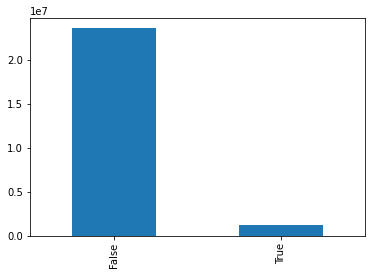

In [ ]:
train_df.label.value_counts().plot.bar()

## Remove Label

In [ ]:
# train_df = train_df.drop("label",axis=1)
# train_df.head(2)

,session_id,timestamp,item_id,category
0,1,2014-04-07T10:51:09.277Z,214536502,0
1,1,2014-04-07T10:54:09.868Z,214536500,0


# Data Construct

## Convert to Datetime

In [ ]:
train_df['timestamp'] = pd.to_datetime(train_df.timestamp)
train_df

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


,session_id,timestamp,item_id,category,label
0,1,2014-04-07 10:51:09.277000+00:00,214536502,0,False
1,1,2014-04-07 10:54:09.868000+00:00,214536500,0,False
2,1,2014-04-07 10:54:46.998000+00:00,214536506,0,False
3,1,2014-04-07 10:57:00.306000+00:00,214577561,0,False
4,2,2014-04-07 13:56:37.614000+00:00,214662742,0,False
...,...,...,...,...,...
33003939,11299809,2014-09-25 09:33:22.412000+00:00,214819412,S,False
33003940,11299809,2014-09-25 09:43:52.821000+00:00,214830939,S,False
33003941,11299811,2014-09-24 19:02:09.741000+00:00,214854855,S,False
33003942,11299811,2014-09-24 19:02:11.894000+00:00,214854838,S,False


In [ ]:
valid_df['timestamp'] = pd.to_datetime(valid_df.timestamp)
valid_df

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


,session_id,timestamp,item_id,category,label
17,7,2014-04-02 06:38:53.104000+00:00,214826835,0,False
18,7,2014-04-02 06:39:05.854000+00:00,214826715,0,False
19,8,2014-04-06 08:49:58.728000+00:00,214838855,0,False
20,8,2014-04-06 08:52:12.647000+00:00,214838855,0,False
36,12,2014-04-02 10:30:13.176000+00:00,214717867,0,True
...,...,...,...,...,...
33003912,11299822,2014-09-28 04:38:10.567000+00:00,214859857,S,False
33003913,11299823,2014-09-29 07:06:28.550000+00:00,214858914,S,False
33003923,11299819,2014-09-25 08:29:28.743000+00:00,214854855,S,False
33003924,11299819,2014-09-25 08:30:27.345000+00:00,214854815,S,False


In [ ]:
test_df['timestamp'] = pd.to_datetime(test_df.timestamp)
test_df

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


,session_id,timestamp,item_id,category,label
19,8,2014-04-06 08:49:58.728000+00:00,214838855,0,False
20,8,2014-04-06 08:52:12.647000+00:00,214838855,0,False
36,12,2014-04-02 10:30:13.176000+00:00,214717867,0,True
37,12,2014-04-02 10:33:12.621000+00:00,214717867,0,True
41,14,2014-04-01 10:09:01.362000+00:00,214577732,0,False
...,...,...,...,...,...
33003912,11299822,2014-09-28 04:38:10.567000+00:00,214859857,S,False
33003913,11299823,2014-09-29 07:06:28.550000+00:00,214858914,S,False
33003923,11299819,2014-09-25 08:29:28.743000+00:00,214854855,S,False
33003924,11299819,2014-09-25 08:30:27.345000+00:00,214854815,S,False


## Second Stage

In [ ]:
!pip3 install swifter
!pip3 install numpy-indexed

### Create Items Probs

In [ ]:
import pickle
item_id_probs =  pickle.load(open("item_id_probs.pickle",'rb'))
item_id_probs

{214507224: 0.0,
 214507226: 0.0,
 214507239: 0.0,
 214507256: 0.0,
 214507331: 0.018,
 214507365: 0.052,
 214507385: 0.06435643564356436,
 214507387: 0.06683804627249357,
 214507408: 0.0738255033557047,
 214507415: 0.04,
 214507445: 0.07716049382716049,
 214507447: 0.072,
 214507477: 0.0,
 214507479: 0.0,
 214507481: 0.0,
 214507492: 0.036,
 214507500: 0.0,
 214507556: 0.07384615384615385,
 214507610: 0.07256235827664399,
 214507678: 0.0,
 214507708: 0.055900621118012424,
 214507723: 0.0,
 214507802: 0.05,
 214507897: 0.0,
 214507927: 0.0,
 214507946: 0.0,
 214507948: 0.0,
 214507982: 0.0,
 214508000: 0.0,
 214508015: 0.0,
 214508027: 0.042483660130718956,
 214508040: 0.0,
 214508066: 0.0,
 214508113: 0.0,
 214508137: 0.0,
 214508143: 0.0,
 214508154: 0.0,
 214508167: 0.0,
 214508203: 0.0,
 214508212: 0.0,
 214508214: 0.0,
 214508225: 0.06569343065693431,
 214508237: 0.0024630541871921183,
 214508244: 0.088,
 214508287: 0.018,
 214508291: 0.0,
 214508304: 0.046,
 214508308: 0.05,
 214

In [ ]:
%%time

import swifter
from tqdm import tqdm
import pandas as pd
from collections import defaultdict
# tqdm.pandas(desc="") last tqdm
tqdm.pandas()

df_summary = train_df
session_id_t = df_summary.groupby('session_id').timestamp.progress_apply(lambda x: x.iloc[0]).to_dict()
df_summary['session_t'] = df_summary['session_id'].map(session_id_t)
df_summary

100%|██████████| 6937296/6937296 [14:04<00:00, 8218.84it/s]


CPU times: user 14min 47s, sys: 8.84 s, total: 14min 56s
Wall time: 14min 52s


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  # This is added back by InteractiveShellApp.init_path()


In [ ]:
item_id_sessions = df_summary.groupby('item_id').progress_apply(lambda x: list(zip(x['session_id'].values, x['session_t'].values, x['label'].values))).to_dict()
item_id_sessions

100%|██████████| 50647/50647 [00:46<00:00, 1081.76it/s]


{214507224: [(2428383,
   numpy.datetime64('2014-05-07T13:29:40.827000000'),
   False),
  (2428382, numpy.datetime64('2014-05-07T07:43:17.982000000'), False),
  (4000944, numpy.datetime64('2014-06-02T08:50:09.758000000'), False),
  (4000944, numpy.datetime64('2014-06-02T08:50:09.758000000'), False),
  (4000944, numpy.datetime64('2014-06-02T08:50:09.758000000'), False),
  (4000944, numpy.datetime64('2014-06-02T08:50:09.758000000'), False),
  (4000944, numpy.datetime64('2014-06-02T08:50:09.758000000'), False),
  (4219789, numpy.datetime64('2014-06-05T08:30:43.787000000'), False),
  (4538804, numpy.datetime64('2014-06-16T12:05:08.623000000'), False),
  (4538804, numpy.datetime64('2014-06-16T12:05:08.623000000'), False),
  (4765238, numpy.datetime64('2014-06-11T12:46:32.207000000'), False),
  (4765238, numpy.datetime64('2014-06-11T12:46:32.207000000'), False),
  (4765238, numpy.datetime64('2014-06-11T12:46:32.207000000'), False),
  (4765238, numpy.datetime64('2014-06-11T12:46:32.207000000'

In [ ]:
MAX_T = 25

item_id_probs = dict()
i = 0
for key,value in item_id_sessions.items():
  if i % 1000 == 0:
    total = len(item_id_sessions)
    print("Current i = ",(i/total) * 100)
  value = list(set(value))[:500]
  item_id_sessions[key] = sorted(value, key = lambda x: x[1])[:MAX_T]

  labels = list(map(lambda x: 1 if x[2] == True else 0,value))
  item_id_probs[key] = np.mean(labels)
  i+=1
item_id_sessions

Current i =  0.0
Current i =  1.9744506091180127
Current i =  3.9489012182360255
Current i =  5.923351827354039
Current i =  7.897802436472051
Current i =  9.872253045590064
Current i =  11.846703654708078
Current i =  13.821154263826092
Current i =  15.795604872944102
Current i =  17.770055482062116
Current i =  19.744506091180128
Current i =  21.718956700298143
Current i =  23.693407309416155
Current i =  25.66785791853417
Current i =  27.642308527652183
Current i =  29.61675913677019
Current i =  31.591209745888204
Current i =  33.56566035500622
Current i =  35.54011096412423
Current i =  37.51456157324225
Current i =  39.489012182360256
Current i =  41.46346279147827
Current i =  43.43791340059629
Current i =  45.412364009714295
Current i =  47.38681461883231
Current i =  49.36126522795033
Current i =  51.33571583706834
Current i =  53.310166446186344
Current i =  55.284617055304366
Current i =  57.25906766442237
Current i =  59.23351827354038
Current i =  61.207968882658406
Curren

{214507224: [(2428382,
   numpy.datetime64('2014-05-07T07:43:17.982000000'),
   False),
  (2428383, numpy.datetime64('2014-05-07T13:29:40.827000000'), False),
  (4000944, numpy.datetime64('2014-06-02T08:50:09.758000000'), False),
  (4219789, numpy.datetime64('2014-06-05T08:30:43.787000000'), False),
  (4765238, numpy.datetime64('2014-06-11T12:46:32.207000000'), False),
  (4538804, numpy.datetime64('2014-06-16T12:05:08.623000000'), False)],
 214507226: [(966402,
   numpy.datetime64('2014-04-17T08:47:02.210000000'),
   False),
  (966403, numpy.datetime64('2014-04-17T12:07:40.390000000'), False),
  (2428382, numpy.datetime64('2014-05-07T07:43:17.982000000'), False),
  (2428384, numpy.datetime64('2014-05-08T12:38:32.090000000'), False),
  (4765238, numpy.datetime64('2014-06-11T12:46:32.207000000'), False)],
 214507239: [(1151253,
   numpy.datetime64('2014-04-16T07:41:50.688000000'),
   False),
  (1070437, numpy.datetime64('2014-04-16T15:38:39.646000000'), False)],
 214507256: [(4765238,
  

In [ ]:
train_df = train_df.drop("session_t",axis=1)
train_df.head(2)

,session_id,timestamp,item_id,category,label
0,1,2014-04-07 10:51:09.277000+00:00,214536502,0,False
1,1,2014-04-07 10:54:09.868000+00:00,214536500,0,False


### Save item_id_probs

In [ ]:
import pickle

pickle.dump(item_id_probs, open("item_id_probs.pickle",'wb'))

In [ ]:
train_df.head()

,session_id,timestamp,item_id,category,label,session_t
0,1,2014-04-07 10:51:09.277000+00:00,214536502,0,False,2014-04-07 10:51:09.277000+00:00
1,1,2014-04-07 10:54:09.868000+00:00,214536500,0,False,2014-04-07 10:51:09.277000+00:00
2,1,2014-04-07 10:54:46.998000+00:00,214536506,0,False,2014-04-07 10:51:09.277000+00:00
3,1,2014-04-07 10:57:00.306000+00:00,214577561,0,False,2014-04-07 10:51:09.277000+00:00
4,2,2014-04-07 13:56:37.614000+00:00,214662742,0,False,2014-04-07 13:56:37.614000+00:00


### Create Sessions_Buyers

In [ ]:
import pandas as pd

db_path = '../yoochoose-buys.dat'
b_cols = ['session_id','timestamp','item_id','price','quantity']
db = pd.read_csv(db_path,sep=',',header=None,names=b_cols)
db = db[db.quantity != 0] # remove noise data
db = db[db.price != 0] # remove noise data
db


,session_id,timestamp,item_id,price,quantity
0,420374,2014-04-06T18:44:58.314Z,214537888,12462,1
1,420374,2014-04-06T18:44:58.325Z,214537850,10471,1
2,281626,2014-04-06T09:40:13.032Z,214535653,1883,1
3,420368,2014-04-04T06:13:28.848Z,214530572,6073,1
4,420368,2014-04-04T06:13:28.858Z,214835025,2617,1
...,...,...,...,...,...
1150748,11368701,2014-09-26T07:52:51.357Z,214849809,554,2
1150749,11368691,2014-09-25T09:37:44.206Z,214700002,6806,5
1150750,11523941,2014-09-25T06:14:47.965Z,214578011,14556,1
1150751,11423202,2014-09-26T18:49:34.024Z,214849164,1046,1


In [ ]:

session_items = db.groupby('session_id')['item_id'].apply(lambda g: set(g.values.tolist())).to_dict()
session_items

{11: {214821371},
 12: {214717867},
 21: {214548744, 214838503},
 33: {214706441, 214820225, 214834865},
 46: {214716932},
 87: {214652220,
  214743369,
  214819430,
  214820392,
  214826837,
  214826908,
  214840483},
 103: {214748293},
 138: {214594592},
 181: {214820231},
 182: {214535621},
 189: {214613865},
 197: {214774685},
 216: {214821277},
 253: {214743341},
 277: {214836958, 214836960},
 291: {214684513},
 293: {214821285, 214826705, 214826803},
 319: {214600625},
 324: {214833802},
 333: {214827062},
 367: {214821290},
 382: {214534852},
 396: {214826801},
 408: {214594680},
 432: {214709807},
 449: {214832557, 214832559},
 484: {214691428},
 507: {214567005, 214717498},
 536: {214821022, 214821024, 214832557, 214832559},
 556: {214821277, 214821285, 214826801, 214826803},
 593: {214585395, 214821290},
 602: {214819562},
 612: {214753507},
 618: {214718203},
 636: {214684513},
 651: {214716930, 214838833},
 656: {214832657},
 664: {214643045},
 669: {214551917},
 688: {2148

### Calculate Features

In [ ]:
ex_g =  train_df[train_df.session_id == 1538798].values
ex_g 

In [ ]:
from collections import defaultdict

def create_f4_f6_f7(group, df_cols, item_arr, unique_items):
  times = group[:,df_cols.index("timestamp")]
  time_diff = [0] + [(t - s).seconds for s, t in zip(times, times[1:])]
  
  f4d = defaultdict(int)
  f6_f7d = defaultdict(list)

  last = item_arr[0]
  for i in range(0,len(item_arr)):
    item_id = item_arr[i] 
    f4d[item_id] += time_diff[i]

    if item_id == last:
        f6_f7d[item_id].append(time_diff[i])

    last = item_id

  def create_f4(item_id):
    return f4d.get(item_id)

  def create_f6(item_id):
    t_list = f6_f7d.get(item_id)
    clicks = 1 if t_list is None else len(t_list) + 1
    return clicks

  def create_f7(item_id):
    t_list = f6_f7d.get(item_id)
    max_dur = max(t_list) if t_list is not None else 0
    return max_dur

  f4_arr = np.vectorize(create_f4)(unique_items)
  f6_arr = np.vectorize(create_f6)(unique_items)
  f7_arr = np.vectorize(create_f7)(unique_items)
  return (f4_arr, f6_arr, f7_arr)

# item_arr = ex_g[:,list(train_df).index('item_id')]
# unique_items = np.unique(item_arr)
# create_f4_f6_f7(ex_g, item_arr, unique_items)

In [ ]:
def create_f5(unique_item):
  def get_item_prob(item_id):
    return item_id_probs.get(item_id,0.0)
  return np.vectorize(get_item_prob)(unique_item)
create_f5(unique_items)

NameError: ignored

In [ ]:
items = np.array([[1],[2],[3],[4],[1],[2],[3],[1]])
feat_cols = (['session_id','item_id','F1','F2','F3','F4','F5','F6','F7'])

def create_feat_from_group(groupi, df_cols, debug=False):
  index_col = df_cols.index('item_id')
  items_array = groupi[:,index_col]

  unique_items, counts = np.unique(items_array, return_counts=True)
  N = unique_items.shape[0]
  F = len(feat_cols)
  X = np.zeros((N,F))

  if debug:
    print("Current group",groupi)
    print("Current item_arr",items_array)
    input()

  session_id = groupi[0][0]
 
  first = items_array[0]
  last = items_array[-1]

  f1 = np.array(first == unique_items)
  f2 = np.array(last == unique_items)
  f3 = counts
  f4,f6,f7 = create_f4_f6_f7(groupi, df_cols, items_array, unique_items)
  f5 = create_f5(unique_items)

  if debug:
    print("first",first)
    print("last",last)
    print("unique_items", unique_items)
    print("Counts",counts)
    input()
   
  X[:,feat_cols.index('session_id')] = session_id
  X[:,feat_cols.index('item_id')] = unique_items 
  X[:,feat_cols.index('F1')] = f1
  X[:,feat_cols.index('F2')] = f2
  X[:,feat_cols.index('F3')] = f3
  X[:,feat_cols.index('F4')] = f4
  X[:,feat_cols.index('F5')] = f5
  X[:,feat_cols.index('F6')] = f6
  X[:,feat_cols.index('F7')] = f7
  return X

In [ ]:
from pandas import Timestamp

# create_feat_from_group(ex_g, list(train_df))

(1538798,
 array([214707875, 214821017, 214821410, 214821412, 214826589, 214834877,
        214834880], dtype=object),
 array([[0.00000000e+00, 0.00000000e+00, 1.00000000e+00, 1.21000000e+02,
         3.53982301e-02, 1.00000000e+00, 0.00000000e+00],
        [0.00000000e+00, 1.00000000e+00, 1.00000000e+00, 1.19000000e+02,
         4.80000000e-02, 1.00000000e+00, 0.00000000e+00],
        [0.00000000e+00, 0.00000000e+00, 6.00000000e+00, 1.46000000e+02,
         8.00000000e-02, 5.00000000e+00, 2.40000000e+01],
        [0.00000000e+00, 0.00000000e+00, 3.00000000e+00, 1.06000000e+02,
         7.00000000e-02, 2.00000000e+00, 2.10000000e+01],
        [0.00000000e+00, 0.00000000e+00, 3.00000000e+00, 7.20000000e+01,
         8.60000000e-02, 2.00000000e+00, 2.50000000e+01],
        [1.00000000e+00, 0.00000000e+00, 2.00000000e+00, 2.70000000e+01,
         8.20000000e-02, 3.00000000e+00, 2.70000000e+01],
        [0.00000000e+00, 0.00000000e+00, 4.00000000e+00, 2.62000000e+02,
         7.20000000e-0

In [ ]:
import numpy_indexed as npi

def create_features(df, debug=False):
  print("Creating features for df.shape",df.shape)
  X = []
  y = []

  df = df[df.label == True] # use just buyers

  arr_df = df.values

  grouped_arr = np.array(npi.group_by(arr_df[:, 0]).split(arr_df[:,0:]))

  total_p = grouped_arr.shape[0]
    
  for k in range(0, total_p):

    if k % 1000 == 0:
      print("Current k ",k/total_p)

    session_id = grouped_arr[k][0][0]

    buyers = session_items[session_id]

    X_i = create_feat_from_group(grouped_arr[k], list(df),debug)
    items_array = X_i[:,1] 
    y_i = list(map(lambda x: x in buyers, items_array))

    X.append(X_i)
    y.append(y_i)


  return X,y



### Construct features

In [ ]:
train_df[train_df.session_id == 11]

,session_id,timestamp,item_id,category,label
24,11,2014-04-03 10:44:35.672000+00:00,214821275,0,True
25,11,2014-04-03 10:45:01.674000+00:00,214821275,0,True
26,11,2014-04-03 10:45:29.873000+00:00,214821371,0,True
27,11,2014-04-03 10:46:12.162000+00:00,214821371,0,True
28,11,2014-04-03 10:46:57.355000+00:00,214821371,0,True
29,11,2014-04-03 10:53:22.572000+00:00,214717089,0,True
30,11,2014-04-03 10:53:49.875000+00:00,214563337,0,True
31,11,2014-04-03 10:55:19.267000+00:00,214706462,0,True
32,11,2014-04-03 10:55:47.327000+00:00,214717436,0,True
33,11,2014-04-03 10:56:30.520000+00:00,214743335,0,True


In [ ]:
session_items[11]

{214821371}

#### train

In [ ]:
X_train, y_train = create_features(train_df, False)  

Creating features for df.shape (24763736, 5)
Current k  0.0
Current k  0.005694922976166747
Current k  0.011389845952333494
Current k  0.017084768928500242
Current k  0.02277969190466699
Current k  0.028474614880833738
Current k  0.034169537857000484
Current k  0.039864460833167234
Current k  0.04555938380933398
Current k  0.051254306785500726
Current k  0.056949229761667476
Current k  0.06264415273783422
Current k  0.06833907571400097
Current k  0.07403399869016772
Current k  0.07972892166633447
Current k  0.0854238446425012
Current k  0.09111876761866795
Current k  0.0968136905948347
Current k  0.10250861357100145
Current k  0.1082035365471682
Current k  0.11389845952333495
Current k  0.11959338249950169
Current k  0.12528830547566844
Current k  0.1309832284518352
Current k  0.13667815142800194
Current k  0.1423730744041687
Current k  0.14806799738033544
Current k  0.1537629203565022
Current k  0.15945784333266894
Current k  0.16515276630883569
Current k  0.1708476892850024
Current k

In [ ]:
!mkdir what_to_buy

In [ ]:
np.save("what_to_buy/X_train.npy",X_train)
np.save("what_to_buy/y_train.npy",y_train)

#### valid

In [ ]:
X_valid, y_valid = create_features(valid_df, False)  

Creating features for df.shape (8240208, 5)
Current k  0.0
Current k  0.017034324163188827
Current k  0.034068648326377654
Current k  0.051102972489566474
Current k  0.06813729665275531
Current k  0.08517162081594412
Current k  0.10220594497913295
Current k  0.11924026914232178
Current k  0.13627459330551062
Current k  0.15330891746869943
Current k  0.17034324163188824
Current k  0.18737756579507708
Current k  0.2044118899582659
Current k  0.22144621412145474
Current k  0.23848053828464355
Current k  0.2555148624478324
Current k  0.27254918661102123
Current k  0.28958351077421
Current k  0.30661783493739886
Current k  0.3236521591005877
Current k  0.3406864832637765
Current k  0.3577208074269653
Current k  0.37475513159015417
Current k  0.391789455753343
Current k  0.4088237799165318
Current k  0.42585810407972063
Current k  0.4428924282429095
Current k  0.45992675240609826
Current k  0.4769610765692871
Current k  0.49399540073247594
Current k  0.5110297248956648
Current k  0.528064049

In [ ]:
np.save("what_to_buy/X_valid.npy",X_valid)
np.save("what_to_buy/y_valid.npy",y_valid)

#### test

In [ ]:
test_df

,session_id,timestamp,item_id,category,label
19,8,NaT,214838855,0,False
20,8,NaT,214838855,0,False
36,12,NaT,214717867,0,True
37,12,NaT,214717867,0,True
41,14,NaT,214577732,0,False
...,...,...,...,...,...
33003912,11299822,NaT,214859857,S,False
33003913,11299823,NaT,214858914,S,False
33003923,11299819,NaT,214854855,S,False
33003924,11299819,NaT,214854815,S,False


In [ ]:
X_test, y_test = create_features(test_df, False)  

Creating features for df.shape (6593988, 5)
Current k  0.0
Current k  0.02126618888628969
Current k  0.04253237777257938
Current k  0.06379856665886906
Current k  0.08506475554515876
Current k  0.10633094443144844
Current k  0.12759713331773812
Current k  0.14886332220402781
Current k  0.17012951109031751
Current k  0.1913956999766072
Current k  0.2126618888628969
Current k  0.23392807774918656
Current k  0.25519426663547623
Current k  0.27646045552176596
Current k  0.29772664440805563
Current k  0.3189928332943453
Current k  0.34025902218063503
Current k  0.3615252110669247
Current k  0.3827913999532144
Current k  0.40405758883950404
Current k  0.4253237777257938
Current k  0.44658996661208344
Current k  0.4678561554983731
Current k  0.48912234438466284
Current k  0.5103885332709525
Current k  0.5316547221572422
Current k  0.5529209110435319
Current k  0.5741870999298215
Current k  0.5954532888161113
Current k  0.616719477702401
Current k  0.6379856665886906
Current k  0.6592518554749

In [ ]:
np.save("what_to_buy/X_test.npy",X_test)
np.save("what_to_buy/y_test.npy",y_test)

## First Stage

In [ ]:
import pickle
item_id_probs =  pickle.load(open("item_id_probs.pickle",'rb'))
item_id_probs

EOFError: ignored

In [ ]:
item_id_probs

{}

In [ ]:
from collections import defaultdict
from  functools import reduce
items = np.array([[1],[2],[3],[4],[1],[2],[3],[1]])
feat_cols = (['P1','P2','P3','P4','P5','P6','P7','P8','P9','P10','P11'])

def create_feat_from_group(groupi, df_cols, debug=False):
  index_col = df_cols.index('item_id')
  items_array = groupi[:,index_col]

  time_col = df_cols.index("timestamp") 
  times = groupi[:,time_col]
  time_diff = [0] + [(t - s).seconds for s, t in zip(times, times[1:])]


  item_all_counts = defaultdict(int)
  item_consecutive_time = defaultdict(list)

  global last
  last = items_array[0]

  def add_to_dicts(row):
    global last
    item_id = row[0]
    time_item = row[1]
    item_all_counts[item_id] += 1
    if last == item_id:
      item_consecutive_time[item_id].append(time_item)
    last = item_id

  maxi_duration = 0.0
  max_consecutive_clicks = 1

  items_array_times = groupi[:,[index_col, time_col]]
  np.apply_along_axis(add_to_dicts, axis=1, arr=items_array_times)

  for key,value in item_consecutive_time.items():
    times_list = item_consecutive_time[key]
    time_diff_by_item = [0] + [(t - s).seconds for s, t in zip(times_list, times_list[1:])]
    max_consecutive_clicks = max(max_consecutive_clicks, len(time_diff_by_item))
    maxi_duration = max(maxi_duration, max(time_diff_by_item)) 
     

  # unique_items, counts = np.unique(items_array, return_counts=True)

  def get_item_prob(item_id):
    return item_id_probs.get(item_id,0.0)
  item_probs = np.vectorize(get_item_prob)(items_array)

  session_id = groupi[0][0]

  N = len(feat_cols)
  X = np.zeros(N)

  p1 = groupi.shape[0]
  p2 = np.mean(list(item_all_counts.values()))

  p3 = (times[0] - times[-1]).seconds
  p4 = max(time_diff)
  p5 = np.mean(time_diff)
  p6 = max(list(item_all_counts.values()))
  p7 = np.mean(item_probs)
  p8 = max(item_probs)
  p9 = (1 -  reduce(lambda x, y: x*y, list(map(lambda x: 1 - x, item_probs))))
  p10 = max_consecutive_clicks
  p11 = maxi_duration

  X[feat_cols.index('P1')] = p1
  X[feat_cols.index('P2')] = p2
  X[feat_cols.index('P3')] = p3
  X[feat_cols.index('P4')] = p4
  X[feat_cols.index('P5')] = p5
  X[feat_cols.index('P6')] = p6
  X[feat_cols.index('P7')] = p7
  X[feat_cols.index('P8')] = p8
  X[feat_cols.index('P9')] = p9
  X[feat_cols.index('P10')] = p10
  X[feat_cols.index('P11')] = p11

  if debug:
    print("current group")
    print(groupi)
    print("X",X)
    input()

  return (session_id, X)

In [ ]:
import numpy_indexed as npi

def create_features(df, debug=False):
  print("Creating features for df.shape",df.shape)
  X = []
  SIT = [] # session_ids with unique_items ordered
  y = []

  arr_df = df.values

  grouped_arr = np.array(npi.group_by(arr_df[:, 0]).split(arr_df[:,0:]))

  total_p = grouped_arr.shape[0]
  
  for k in range(0, total_p):
      S_i, X_i = create_feat_from_group(grouped_arr[k], list(df),debug)

      SIT.append(S_i)
      y.append(grouped_arr[k][:,list(df).index("label")][0])
      X.append(X_i)

      if k % 10000 == 0:
        print("Completed: %.2f" % (k/total_p))

  return X, SIT,y

### Create features

In [ ]:
s_parts = np.array_split(train_df.session_id.unique(), 10)
s_parts

[array([      1,       2,       3, ..., 1206142, 1206141, 1206138]),
 array([1206136, 1206137, 1206134, ..., 2354901, 2354451, 2354452]),
 array([2354456, 2354457, 2354461, ..., 3482727, 3482721, 3482749]),
 array([3482748, 3482751, 3482744, ..., 4689722, 4689723, 4689721]),
 array([4689718, 4689719, 4689717, ..., 5837339, 5837338, 5837337]),
 array([5837336, 5837342, 5837341, ..., 6854921, 6854922, 6854923]),
 array([6854927, 6854912, 6854913, ..., 8503098, 8367409, 8503097]),
 array([8503096, 8367411, 8503094, ..., 9246246, 9246244, 9246264]),
 array([ 9246271,  9246268,  9246269, ..., 10359202, 10359203, 10359398]),
 array([10359397, 10359396, 10359394, ..., 11299808, 11299809, 11299811])]

In [ ]:
!mkdir buy_or_not/slices/

mkdir: cannot create directory ‘buy_or_not/slices/’: File exists


In [ ]:
i = 0
for sids_part in s_parts:
  print("Current i = ",i)
  train_part = train_df[train_df.session_id.isin(sids_part)]
  X_train_i, SIT_train_i, y_train_i = create_features(train_part, False)  
  np.save("buy_or_not/slices/X_train_%d.npy" % (i),X_train_i)
  np.save("buy_or_not/slices/SIT_train_%d.npy" % (i),SIT_train_i)
  np.save("buy_or_not/slices/y_train_%d.npy" % (i),y_train_i)
  i+=1

Current i = 0 0
Creating features for df.shape (2734106, 5)
Completed: 0.00
Completed: 0.01
Completed: 0.03
Completed: 0.04
Completed: 0.06
Completed: 0.07
Completed: 0.09
Completed: 0.10
Completed: 0.12
Completed: 0.13
Completed: 0.14
Completed: 0.16
Completed: 0.17
Completed: 0.19
Completed: 0.20
Completed: 0.22
Completed: 0.23
Completed: 0.25
Completed: 0.26
Completed: 0.27
Completed: 0.29
Completed: 0.30
Completed: 0.32
Completed: 0.33
Completed: 0.35
Completed: 0.36
Completed: 0.37
Completed: 0.39
Completed: 0.40
Completed: 0.42
Completed: 0.43
Completed: 0.45
Completed: 0.46
Completed: 0.48
Completed: 0.49
Completed: 0.50
Completed: 0.52
Completed: 0.53
Completed: 0.55
Completed: 0.56
Completed: 0.58
Completed: 0.59
Completed: 0.61
Completed: 0.62
Completed: 0.63
Completed: 0.65
Completed: 0.66
Completed: 0.68
Completed: 0.69
Completed: 0.71
Completed: 0.72
Completed: 0.74
Completed: 0.75
Completed: 0.76
Completed: 0.78
Completed: 0.79
Completed: 0.81
Completed: 0.82
Completed: 0

In [ ]:
X_valid, SIT_valid, y_valid = create_features(valid_df, False)  

Creating features for df.shape (8240208, 5)
Completed: 0.00
Completed: 0.00
Completed: 0.01
Completed: 0.01
Completed: 0.02
Completed: 0.02
Completed: 0.03
Completed: 0.03
Completed: 0.03
Completed: 0.04
Completed: 0.04
Completed: 0.05
Completed: 0.05
Completed: 0.06
Completed: 0.06
Completed: 0.06
Completed: 0.07
Completed: 0.07
Completed: 0.08
Completed: 0.08
Completed: 0.09
Completed: 0.09
Completed: 0.10
Completed: 0.10
Completed: 0.10
Completed: 0.11
Completed: 0.11
Completed: 0.12
Completed: 0.12
Completed: 0.13
Completed: 0.13
Completed: 0.13
Completed: 0.14
Completed: 0.14
Completed: 0.15
Completed: 0.15
Completed: 0.16
Completed: 0.16
Completed: 0.16
Completed: 0.17
Completed: 0.17
Completed: 0.18
Completed: 0.18
Completed: 0.19
Completed: 0.19
Completed: 0.19
Completed: 0.20
Completed: 0.20
Completed: 0.21
Completed: 0.21
Completed: 0.22
Completed: 0.22
Completed: 0.22
Completed: 0.23
Completed: 0.23
Completed: 0.24
Completed: 0.24
Completed: 0.25
Completed: 0.25
Completed: 0

In [ ]:
np.save("buy_or_not/X_valid.npy",X_valid)
np.save("buy_or_not/SIT_valid.npy",SIT_valid)
np.save("buy_or_not/y_valid.npy",y_valid)

In [ ]:
X_test, SIT_test, y_test = create_features(test_df, False)  

Creating features for df.shape (6593988, 5)
Completed: 0.00
Completed: 0.01
Completed: 0.01
Completed: 0.02
Completed: 0.02
Completed: 0.03
Completed: 0.03
Completed: 0.04
Completed: 0.04
Completed: 0.05
Completed: 0.05
Completed: 0.06
Completed: 0.06
Completed: 0.07
Completed: 0.08
Completed: 0.08
Completed: 0.09
Completed: 0.09
Completed: 0.10
Completed: 0.10
Completed: 0.11
Completed: 0.11
Completed: 0.12
Completed: 0.12
Completed: 0.13
Completed: 0.14
Completed: 0.14
Completed: 0.15
Completed: 0.15
Completed: 0.16
Completed: 0.16
Completed: 0.17
Completed: 0.17
Completed: 0.18
Completed: 0.18
Completed: 0.19
Completed: 0.19
Completed: 0.20
Completed: 0.21
Completed: 0.21
Completed: 0.22
Completed: 0.22
Completed: 0.23
Completed: 0.23
Completed: 0.24
Completed: 0.24
Completed: 0.25
Completed: 0.25
Completed: 0.26
Completed: 0.26
Completed: 0.27
Completed: 0.28
Completed: 0.28
Completed: 0.29
Completed: 0.29
Completed: 0.30
Completed: 0.30
Completed: 0.31
Completed: 0.31
Completed: 0

In [ ]:
np.save("buy_or_not/X_test.npy",X_test)
np.save("buy_or_not/SIT_test.npy",SIT_test)
np.save("buy_or_not/y_test.npy",y_test)

### Concat Train

In [ ]:
i = 0

def flat_list(l):
  return np.array([item for sublist in l for item in sublist])

X_train = []
SIT_train = []
y_train = []

for sids_part in s_parts:
  print("Current i ",i)
  X_train_i = np.load("buy_or_not/slices/X_train_%d.npy" % (i))
  SIT_train_i = np.load("buy_or_not/slices/SIT_train_%d.npy" % (i))
  y_train_i = np.load("buy_or_not/slices/y_train_%d.npy" % (i))

  X_train.append(X_train_i)
  SIT_train.append(SIT_train_i)
  y_train.append(y_train_i)
  i+=1


X_train = flat_list(X_train)
y_train = flat_list(y_train)
SIT_train = flat_list(SIT_train)

print(X_train.shape)

Current i  0
Current i  1
Current i  2
Current i  3
Current i  4
Current i  5
Current i  6
Current i  7
Current i  8
Current i  9
(6937296, 11)


In [ ]:
np.save("buy_or_not/X_train.npy",X_train)
np.save("buy_or_not/SIT_train.npy",SIT_train)
np.save("buy_or_not/y_train.npy",y_train)

# Model

## First Stage

In [ ]:
X_train = np.load("buy_or_not/X_train.npy")
y_train = np.load("buy_or_not/y_train.npy")

In [ ]:
X_valid = np.load("buy_or_not/X_valid.npy")
y_valid = np.load("buy_or_not/y_valid.npy")

In [ ]:
from imblearn.under_sampling import RandomUnderSampler
rus = RandomUnderSampler(random_state=42)
X_train, y_train = rus.fit_resample(X_train, y_train)
X_train.shape

/usr/local/lib/python3.6/dist-packages/sklearn/externals/six.py:31: FutureWarning: The module is deprecated in version 0.21 and will be removed in version 0.23 since we've dropped support for Python 2.7. Please rely on the official version of six (https://pypi.org/project/six/).
  "(https://pypi.org/project/six/).", FutureWarning)
/usr/local/lib/python3.6/dist-packages/sklearn/utils/deprecation.py:144: FutureWarning: The sklearn.neighbors.base module is  deprecated in version 0.22 and will be removed in version 0.24. The corresponding classes / functions should instead be imported from sklearn.neighbors. Anything that cannot be imported from sklearn.neighbors is now part of the private API.
  warnings.warn(message, FutureWarning)
/usr/local/lib/python3.6/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function safe_indexing is deprecated; safe_indexing is deprecated in version 0.22 and will be removed in version 0.24.
  warnings.warn(msg, category=FutureWarning)


(351190, 11)

In [ ]:
import matplotlib.pyplot as plt
from collections import Counter

Counter(y_train)

Counter({False: 175595, True: 175595})

In [ ]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.datasets import make_classification
from sklearn.metrics import classification_report


clf = RandomForestClassifier(max_depth=None, min_samples_split = 200, random_state=0, verbose=1,n_jobs=20)
clf.fit(X_train, y_train)


[Parallel(n_jobs=20)]: Using backend ThreadingBackend with 20 concurrent workers.
[Parallel(n_jobs=20)]: Done  10 tasks      | elapsed:    1.0s
[Parallel(n_jobs=20)]: Done 100 out of 100 | elapsed:    4.5s finished


RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight=None,
                       criterion='gini', max_depth=None, max_features='auto',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=200,
                       min_weight_fraction_leaf=0.0, n_estimators=100,
                       n_jobs=20, oob_score=False, random_state=0, verbose=1,
                       warm_start=False)

In [ ]:
y_pred = clf.predict(X_valid)


[Parallel(n_jobs=20)]: Using backend ThreadingBackend with 20 concurrent workers.
[Parallel(n_jobs=20)]: Done  10 tasks      | elapsed:    0.5s
[Parallel(n_jobs=20)]: Done 100 out of 100 | elapsed:    2.3s finished


In [ ]:
print(classification_report(y_valid, y_pred, target_names=['non_buyer','buyer']))

              precision    recall  f1-score   support

   non_buyer       0.99      0.79      0.88   2253728
       buyer       0.09      0.80      0.16     58705

    accuracy                           0.79   2312433
   macro avg       0.54      0.79      0.52   2312433
weighted avg       0.97      0.79      0.86   2312433



In [ ]:
import pickle
filename = 'randomforest.sav'
pickle.dump(clf, open(filename, 'wb'))

In [ ]:
import pandas as pd

report = (classification_report(y_valid, y_pred, target_names=['non_buyer','buyer']))
df = pd.DataFrame(report).transpose()

df.to_csv("class_report.csv")

ValueError: ignored

## Second Stage

In [ ]:
X_train = np.load("what_to_buy/X_train.npy",allow_pickle=True)
y_train = np.load("what_to_buy/y_train.npy",allow_pickle=True)

In [ ]:
X_valid = np.load("buy_or_not/X_valid.npy",allow_pickle=True)
y_valid = np.load("buy_or_not/y_valid.npy",allow_pickle=True)

In [ ]:
X_train[np.where(y_train==True)[0]][1]

array([[0.00e+00, 1.00e+00, 1.00e+00, 8.07e+02, 8.00e-03, 1.00e+00,
        0.00e+00],
       [1.00e+00, 0.00e+00, 5.00e+00, 3.72e+02, 4.80e-02, 6.00e+00,
        1.31e+02]])

In [ ]:
def flat_list(l):
  return np.array([item for sublist in l for item in sublist])


In [ ]:
X_valid = flat_list(X_valid)
y_valid = flat_list(y_valid)

In [ ]:
X_train = flat_list(X_train)
y_train = flat_list(y_train)


X_train.shape

(803492, 9)

In [ ]:
X_test = flat_list(X_test)
y_test = flat_list(y_test)



In [ ]:
X_train = X_train[:,2:] # remove session id, item_id

In [ ]:
X_valid = X_valid[:,2:] # remove session id, item_id

In [ ]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.datasets import make_classification
from sklearn.metrics import classification_report


clf = RandomForestClassifier(max_depth=None, min_samples_split = 350, random_state=0, verbose=1,n_jobs=20)
clf.fit(X_train, y_train)

[Parallel(n_jobs=20)]: Using backend ThreadingBackend with 20 concurrent workers.
[Parallel(n_jobs=20)]: Done  10 tasks      | elapsed:    1.8s
[Parallel(n_jobs=20)]: Done 100 out of 100 | elapsed:    8.9s finished


RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight=None,
                       criterion='gini', max_depth=None, max_features='auto',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=350,
                       min_weight_fraction_leaf=0.0, n_estimators=100,
                       n_jobs=20, oob_score=False, random_state=0, verbose=1,
                       warm_start=False)

In [ ]:
y_pred = clf.predict(X_valid)

[Parallel(n_jobs=20)]: Using backend ThreadingBackend with 20 concurrent workers.
[Parallel(n_jobs=20)]: Done  10 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 100 out of 100 | elapsed:    0.4s finished


In [ ]:
print(classification_report(y_valid, y_pred, target_names=['non_buyer','buyer']))

              precision    recall  f1-score   support

   non_buyer       0.73      0.84      0.78    144092
       buyer       0.77      0.65      0.70    123863

    accuracy                           0.75    267955
   macro avg       0.75      0.74      0.74    267955
weighted avg       0.75      0.75      0.75    267955



In [ ]:
y_pred = clf.predict(X_test[:,2:])
print(classification_report(y_test, y_pred, target_names=['non_buyer','buyer']))

[Parallel(n_jobs=20)]: Using backend ThreadingBackend with 20 concurrent workers.
[Parallel(n_jobs=20)]: Done  10 tasks      | elapsed:    0.1s
[Parallel(n_jobs=20)]: Done 100 out of 100 | elapsed:    0.3s finished


              precision    recall  f1-score   support

   non_buyer       0.73      0.84      0.78    115733
       buyer       0.77      0.64      0.70     99076

    accuracy                           0.75    214809
   macro avg       0.75      0.74      0.74    214809
weighted avg       0.75      0.75      0.75    214809



In [ ]:
X_train[:,0:]

array([[1.10000000e+01, 2.14563337e+08, 0.00000000e+00, ...,
        7.80000000e-02, 1.00000000e+00, 0.00000000e+00],
       [1.10000000e+01, 2.14706462e+08, 0.00000000e+00, ...,
        1.14000000e-01, 1.00000000e+00, 0.00000000e+00],
       [1.10000000e+01, 2.14717089e+08, 0.00000000e+00, ...,
        5.40000000e-02, 1.00000000e+00, 0.00000000e+00],
       ...,
       [1.15620970e+07, 2.14861498e+08, 1.00000000e+00, ...,
        9.20000000e-02, 3.00000000e+00, 5.00000000e+00],
       [1.15621210e+07, 2.14540691e+08, 0.00000000e+00, ...,
        4.20000000e-02, 1.00000000e+00, 0.00000000e+00],
       [1.15621210e+07, 2.14839339e+08, 1.00000000e+00, ...,
        3.80000000e-02, 2.00000000e+00, 0.00000000e+00]])

/usr/local/lib/python3.6/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function safe_indexing is deprecated; safe_indexing is deprecated in version 0.22 and will be removed in version 0.24.
  warnings.warn(msg, category=FutureWarning)


(741084, 7)